In [27]:
%matplotlib inline
%load_ext memory_profiler

import os, sys, glob, re, math, pickle
import phate,scprep,magic,meld
import graphtools as gt
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import time,random,datetime
from sklearn import metrics
from sklearn import model_selection
from scipy import sparse
from scipy.stats import mannwhitneyu, tiecorrect, rankdata, zscore
from statsmodels.stats.multitest import multipletests
import scanpy as sc
import scvelo as scv
from adjustText import adjust_text
import warnings



# settings
plt.rc('font', size = 9)
plt.rc('font', family='sans serif')
plt.rcParams['pdf.fonttype']=42
plt.rcParams['ps.fonttype']=42
plt.rcParams['text.usetex']=False
plt.rcParams['legend.frameon']=False
plt.rcParams['axes.grid']=False
plt.rcParams['legend.markerscale']=0.5
sc.set_figure_params(dpi=300,dpi_save=600,
                     frameon=False,
                     fontsize=9)
plt.rcParams['savefig.dpi']=600
sc.settings.verbosity=2
sc._settings.ScanpyConfig.n_jobs=-1
scv.settings.n_jobs=-1
sns.set_style("ticks")


The memory_profiler extension is already loaded. To reload it, use:
  %reload_ext memory_profiler


In [2]:

# fps
dfp = '/home/ngr4/project/scnd/data/'
pfp = '/home/ngr4/project/scnd/results/'
pdfp = '/home/ngr4/project/scnd/data/processed/'
sc.settings.figdir = pfp
scv.settings.figdir = pfp


def loader(fname,fpath,backed=None) : 
    start = time.time()
    adata = sc.read_h5ad(filename=os.path.join(fpath,fname),backed=backed)
    print('loaded @'+datetime.datetime.now().strftime('%y%m%d.%H:%M:%S'))
    print('took {:.2f}-s to load data'.format(time.time()-start))
    return adata

def writer(fname,fpath,AnnData) :
    start = time.time()
    Anndata.write(os.path.join(fpath,fname))
    print('saved @'+datetime.datetime.now().strftime('%y%m%d.%H:%M:%S'))
    print('took {:.2f}-s to save data'.format(time.time()-start))
    

if False :
    # load human
    fname='hum_MT_bbknn.h5ad'
    %memit hdata = loader(fname,pdfp)
    
if True :
    # load mouse
    fname='mouse_MT_bbknn.h5ad'
    %memit mdata = loader(fname,pdfp)


loaded @200512.14:16:41
took 155.95-s to load data
peak memory: 149458.26 MiB, increment: 149253.94 MiB


In [20]:
# aesthetic
cmap_ctype={'Granule cell': '#FAC18A',
            'Unipolar brush cell': '#BA61BA',
            'Purkinje cell': '#EE5264',
            'GABAergic interneuron 1': '#F9EBAE',
            'GABAergic interneuron 2': '#88BB92',
            'GABAergic interneuron 3': '#46A928',
            'Astrocyte': '#F9AEAE',
            'Bergmann glia': '#AEB7F9',
            'Oligodendrocyte progenitor cell': '#F1815F',
            'Oligodendrocyte': '#75A3B7',
            'Microglia': '#AC5861',
            'Pericyte': '#2D284B',
            'Endothelial cell': '#1C67EE'}

cmap_genotype={'WT':'#010101',
               'SCA1':'#ffd478'}

In [16]:
interactors = []
with open(os.path.join(pfp,'atxn_interactors.csv')) as f:
    for line in f:
        gene = line.rstrip()
        gene = gene[0] + gene[1:].lower()
        interactors.append(gene)
f.close()

missing_interactors = pd.read_csv(os.path.join(pfp,'missing_interactors.csv'), header=None).iloc[:,[0,1]].dropna()
missing_interactors = {missing_interactors.iloc[i,0]:missing_interactors.iloc[i,1] for i in range(missing_interactors.shape[0])}
interactors = pd.Series(interactors).replace(missing_interactors).to_list()

In [17]:
# make pd.DataFrame out of those 
adata = sc.AnnData(mdata[:,notmissing]) # Atxn1 already in data

# create dataframe
X = pd.DataFrame({'ctype':adata.obs['ctype'],
                  'gtype':adata.obs['genotype'],
                  'time':adata.obs['timepoint']}) # can add time here, if interested

x = pd.DataFrame(adata.layers['imputed_bbknn'],
                 columns=adata.var_names,
                 index=adata.obs.index)

X = pd.merge(X,x, left_index=True,right_index=True)

# Correlation

In [122]:
dt = x.to_frame().T
dt['ctype']=c
dt['gtype']=g

In [129]:
corr = pd.DataFrame()
counter=0
for g in X['gtype'].unique():
    for c in X['ctype'].unique():
        tic = time.time()
        counter += 1
        x = X.loc[((X['ctype']==c) & (X['gtype']==g)),notmissing]
        x = x.corrwith(x['Atxn1'], method='spearman')
        dt = x.to_frame().T
        dt['ctype']=c
        dt['gtype']=g
        corr = corr.append(dt, ignore_index=True)
        toc = time.time() - tic
        total_n = len(X['gtype'].unique())*len(X['ctype'].unique())
        print('{}/{} in {:.1f}-s, {:.1f}-s left'.format(counter,total_n,toc,toc*(total_n-counter)))
corr = corr.drop(columns='Atxn1') # drop Atxn1

1/26 in 0.8-s, 19.5-s left
2/26 in 14.0-s, 335.4-s left
3/26 in 0.6-s, 14.3-s left
4/26 in 0.8-s, 18.2-s left
5/26 in 0.6-s, 11.6-s left
6/26 in 0.4-s, 7.2-s left
7/26 in 0.8-s, 14.6-s left
8/26 in 0.5-s, 9.5-s left
9/26 in 0.5-s, 8.3-s left
10/26 in 0.4-s, 6.3-s left
11/26 in 0.4-s, 6.6-s left
12/26 in 0.4-s, 5.0-s left
13/26 in 0.4-s, 4.7-s left
14/26 in 0.7-s, 8.1-s left
15/26 in 13.1-s, 144.0-s left
16/26 in 0.7-s, 7.3-s left
17/26 in 0.9-s, 8.4-s left
18/26 in 0.4-s, 3.1-s left
19/26 in 0.4-s, 2.6-s left
20/26 in 0.6-s, 3.8-s left
21/26 in 0.5-s, 2.3-s left
22/26 in 0.4-s, 1.8-s left
23/26 in 0.4-s, 1.1-s left
24/26 in 0.4-s, 0.8-s left
25/26 in 0.4-s, 0.4-s left
26/26 in 0.3-s, 0.0-s left


In [19]:
# aesthetic

# map to series
corr['ctype_colors'] = corr['ctype'].map(cmap_ctype)
corr['gtype_colors'] = corr['gtype'].map(cmap_genotype)

NameError: name 'corr' is not defined

In [138]:
corr['ctype_colors'] = corr['ctype'].map(cmap_ctype)
corr['gtype_colors'] = corr['gtype'].map(cmap_genotype)

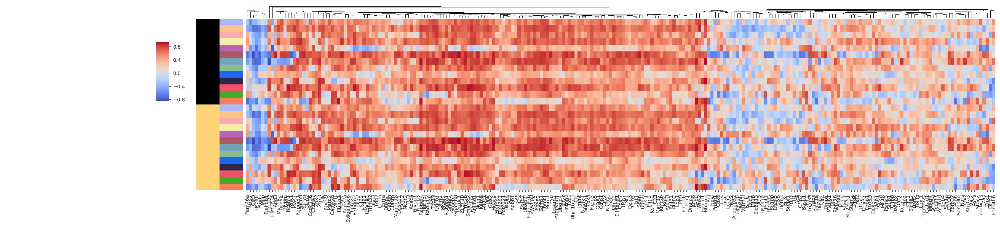

In [152]:
cols = [i for i in corr.columns if i not in ['ctype','gtype','gtype_colors','ctype_colors']]
p = sns.clustermap(corr[cols], 
                   cmap='coolwarm',
                   col_cluster=True,
                   row_cluster=False,
                   row_colors=[corr['gtype_colors'],corr['ctype_colors']],
                   xticklabels=True,
                   yticklabels=False,
                   figsize=(32,6))
p.cax.set_position([0.3, .5, .01, .25])
p.savefig(os.path.join(pfp,'interactors_heatmap.pdf'),bbox_inches='tight')

# Expression


In [ ]:
# make pd.DataFrame out of those 
adata = sc.AnnData(mdata[:,notmissing]) # Atxn1 already in data

# create dataframe
X = pd.DataFrame({'ctype':adata.obs['ctype'],
                  'gtype':adata.obs['genotype'],
                  'time':adata.obs['timepoint']}) # can add time here, if interested

x = pd.DataFrame(adata.layers['imputed_bbknn'],
                 columns=adata.var_names,
                 index=adata.obs.index)

X = pd.merge(X,x, left_index=True,right_index=True)

## Per timepoint, per genotype

In [78]:
for t in ['5wk','12wk','18wk','24wk','30wk']:
    x = X.loc[X['time']==t,:]
    x = x.set_index(['ctype','gtype'])
    x = x.drop(columns=['time'])
    x[x.columns] = zscore(x,axis=0)
    x = x.reset_index()
    x = x.groupby(['ctype','gtype']).mean()
    x = x.reset_index()
    # x = x.set_index(['/ctype','gtype'])
    x['ctype_colors'] = x['ctype'].map(cmap_ctype)
    x['gtype_colors'] = x['gtype'].map(cmap_genotype)

    for condition in ['WT','SCA1']: 
        x_condition = x.loc[x['gtype']==condition]
        cols = [i for i in x.columns if i not in ['ctype','gtype','gtype_colors','ctype_colors']]
        p = sns.clustermap(x_condition[cols], 
                           cmap='magma',
                           col_cluster=True,
                           row_cluster=True,
                           row_colors=[x_condition['gtype_colors'],x_condition['ctype_colors']],
                           xticklabels=True,
                           yticklabels=False,
                           vmin=-2,vmax=2,
                           figsize=(32,6))
        p.cax.set_position([0.1, 0.1, .008, .25])
        p.savefig(os.path.join(pfp,'atxn1ints_aveZscore_{}_{}.pdf'.format(t,condition)),bbox_inches='tight')




In [75]:
# SORT BY LEON ORDER?
if False:
    order = ['Granule cell',
             'Unipolar brush cell',
             'Purkinje cell',
             'GABAergic interneuron 1',
             'GABAergic interneuron 2',
             'GABAergic interneuron 3',
             'Astrocyte',
             'Bergmann glia',
             'Oligodendrocyte progenitor cell',
             'Oligodendrocyte',
             'Microglia',
             'Pericyte',
             'Endothelial cell',]
    
    x_condition['ctype'] = x_condition['ctype'].cat.reorder_categories(order)
    x_condition = x_condition.sort_values(by='ctype')
    
    p = sns.clustermap(x_condition[cols], 
                       cmap='magma',
                       col_cluster=True,
                       row_cluster=False,
                       row_colors=[x_condition['gtype_colors'],x_condition['ctype_colors']],
                       xticklabels=True,
                       yticklabels=False,
                       vmin=-2,vmax=2,
                       figsize=(32,6))
    p.cax.set_position([0.3, .5, .01, .25])

## all timepoints, per genotype

Showing expression 


In [80]:
t = 'allt'
x = X
x = x.set_index(['ctype','gtype'])
x = x.drop(columns=['time'])
x[x.columns] = zscore(x,axis=0)
x = x.reset_index()
x = x.groupby(['ctype','gtype']).mean()
x = x.reset_index()
# x = x.set_index(['/ctype','gtype'])
x['ctype_colors'] = x['ctype'].map(cmap_ctype)
x['gtype_colors'] = x['gtype'].map(cmap_genotype)

for condition in ['WT','SCA1']: 
    x_condition = x.loc[x['gtype']==condition]
    cols = [i for i in x.columns if i not in ['ctype','gtype','gtype_colors','ctype_colors']]
    p = sns.clustermap(x_condition[cols], 
                       cmap='magma',
                       col_cluster=True,
                       row_cluster=True,
                       row_colors=[x_condition['gtype_colors'],x_condition['ctype_colors']],
                       xticklabels=True,
                       yticklabels=False,
#                        vmin=-2,vmax=2,
                       figsize=(32,6))
    p.cax.set_position([0.1, 0.1, .008, .25])
    p.savefig(os.path.join(pfp,'atxn1ints_aveZscore_{}_{}.pdf'.format(t,condition)),bbox_inches='tight')


